# Robust MPC full code

In [ ]:
# Import all the packages we need
import numpy as np
import pandas as pd
from typing import Optional, Tuple

import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

import pickle
from pickle import dump
from sklearn.preprocessing import MinMaxScaler
import time
from torch.nn import ReLU

# from pytorch_forecasting.metrics.quantile import QuantileLoss

# For LSTM
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
from tqdm import tqdm
if torch.cuda.is_available():
    print("cuda is available")
else:
    print("cuda is NOT available")

from sklearn.preprocessing import StandardScaler
import torch.autograd.functional as F

# For TFT
from tqdm import tqdm_notebook as tqdm

import warnings

warnings.filterwarnings("ignore")
import logging

logging.disable(logging.CRITICAL)


# import functions
from TiDE import TideModule, quantile_loss, TiDE_forward
from sys_model import nominal_model, nominal_model_recur, system_model
from RobustMPC_pytorch import RMPC_pytorch_iteration
from utils import sigmoid, LossParameters, GlobalState


cuda is available


## Load pre-trained models

### Load nominal model

In [2]:
# # Window = 1 =================================================
# # Open the pickle file
# with open('nominal_params_w1_more.pkl', 'rb') as file:
#     # 2. Load the data from the pickle file
#     nominal_params = pickle.load(file)
# # Load nominal TiDE model
# nominal_TiDE = nominal_params['model'].to("cpu")
# nominal_TiDE.load_state_dict(torch.load('nominal_params_w1_more.pth'))
# nominal_TiDE.eval()
# window = 10
# P = 10

# Window = 1, OK ============================================
# Open the pickle file
with open('nominal_params_w10_mid_noise_stable_final.pkl', 'rb') as file:
    # 2. Load the data from the pickle file
    nominal_params = pickle.load(file)
# Load nominal TiDE model
nominal_TiDE = nominal_params['model'].to("cpu")
nominal_TiDE.load_state_dict(torch.load('nominal_params_w10_mid_noise_stable_final.pth'))
nominal_TiDE.eval()
window = 10





### Load tube model

In [3]:
# Open the pickle file
with open('controlled_quantile_params_w10_mid_noise_with_x.pkl', 'rb') as file:
    # 2. Load the data from the pickle file
    tube_params = pickle.load(file)
# Load nominal TiDE model
tube_TiDE = tube_params['model'].to("cpu")
tube_TiDE.load_state_dict(torch.load('controlled_quantile_TiDE_w10_mid_noise_with_x_smaller_k_5_quantile.pth'))
tube_TiDE = tube_TiDE.eval()
P = 10

### Load reference trajectory

In [13]:
path = ''
data = pd.read_pickle(path + 'open_loop_data_SISO.pkl')

data["y"][1:] = data["y"][0:-1]
Ref_traj = data["y"].values
Ref_traj = np.concatenate((np.zeros((20)),Ref_traj))

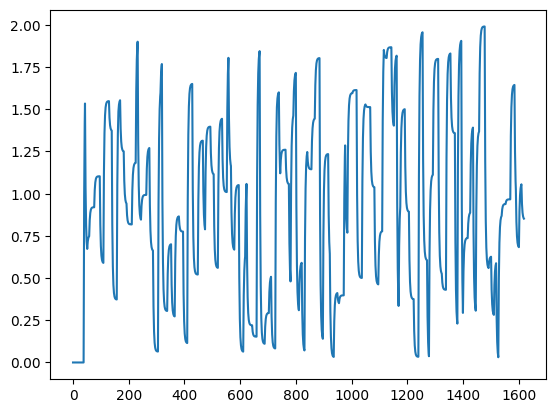

In [14]:
plt.plot(Ref_traj)

### Objective function with checking constraint

In [7]:
# Utils

LossParam = LossParameters(alpha0=1, delta_alpha = 3, lamda0 = 10)
relu = ReLU()
global_state = GlobalState()


def RMPC_obj_TiDE_pytorch_w_x(u_hat:torch.tensor, # future u values within the control horizon, length = M; this should be the warm start version
                u_past:torch.tensor, # past u
                x_past: torch.tensor, # past state of x, size (N,window)
                SP_hat:torch.tensor, # Reference trajectory, length = P
                P, # Predictive Horizon
                NN_Nominal, # Nominal TiDE model that we're using
                tube_model = None,
                error_history = None,
                x_max=None,
                x_min=None,
                u_max=None,
                u_min=None,
                constraint_evaluation = True
):
    
    # convert u_hat into tensor and set u_hat as variable
    u_hat_in = u_hat.unsqueeze(0)
    
    # knit past and future covariate into the input format for TiDE
    past_cov = torch.tensor(np.concatenate((x_past,u_past), axis = 0),dtype=torch.float32).transpose(1,0).unsqueeze(0)
    # TiDE prediction
    x_hat_s_all = NN_Nominal([past_cov,u_hat_in,None]) # normalized value
    
    # compute objective value
    x_hat_s = x_hat_s_all[0,:,0,1]
    u_hat_temp = u_hat_in[0,:,0].reshape(-1,1) 

    u = u_hat_temp[0].reshape(-1,1)
    u_hat0 = torch.concatenate((u,u_hat_temp)) # append the computed u with the history u
    
    Obj = 1 * torch.sum((x_hat_s-torch.tensor(SP_hat,dtype=torch.float32))**2) + 1*torch.sum((u_hat0[1:]-u_hat0[0:-1])**2) 
            #+ 10*(x_hat_s[-1]-torch.tensor(SP_hat[0,-1]))**2


    if constraint_evaluation == False:
        return Obj
    else:
        return Obj, x_hat_s_all
    


def x_constraint_check_w_x(u_hat, u_past_s, tube_model, tube_params, error_history, x_past_s, x_hat_s, x_max, x_min, u_max, u_min, NN_nominal):
    
    # ======= Median Prediction   =========
    # convert x_hat_s into original scale
    x_hat_s_med = x_hat_s[0,:,:,1]
    x_hat = ((x_hat_s_med + 1).reshape(-1,2) * 0.5 * ((x_max-x_min).reshape(-1,2)) + x_min.reshape(-1,2))[:,:] # shape:[P,2]
    
    # ======== x nominal quantile =========
    x_lower_quantile = ((x_hat_s[0,:,:,0] + 1).reshape(-1,2) * 0.5 * ((x_max-x_min).reshape(-1,2)) + x_min.reshape(-1,2))
    x_upper_quantile = ((x_hat_s[0,:,:,2] + 1).reshape(-1,2) * 0.5 * ((x_max-x_min).reshape(-1,2)) + x_min.reshape(-1,2))
    
    # ======= Past x ====================
    # convert x_past_s into original scale
    x_past = ((x_past_s + 1).reshape(2,-1) * 0.5 * ((x_max-x_min).reshape(2,-1)) + x_min.reshape(2,-1)).transpose(1,0) # shape: [P,2]

    
    # ======= Tube Prediction ===========    
    # use the u, x and e in original scale to predict tube quantile
    
    # convert u_scaled into original scale
    u_max = torch.tensor(u_max)
    u_min = torch.tensor(u_min)
    u_original_scale = (u_hat + 1).reshape(-1,1)*0.5*(u_max-u_min).reshape(-1,1) + u_min.reshape(-1,1) # shape: [P,2]
    
    # convert u_past_s to original scale
    u_past = (u_past_s + 1).reshape(-1,1)*0.5*(u_max-u_min).reshape(-1,1) + u_min.reshape(-1,1)        # shape: [window,1]

    # load error history (it should be saved in original scale already)
    if torch.all(error_history) == 0:
        error_history = error_history.transpose(1,0) # shape = [10,2]
    else:
        error_history = error_history.transpose(1,0).reshape(-1,2) # shape = [10,2]
    
    # predict future error        
    past_cov_error = torch.concatenate((error_history,x_past,u_past), axis = 1).unsqueeze(0) # shape = [1,P,3]
    future_cov = torch.concatenate((x_hat,u_original_scale),axis = 1).unsqueeze(0)
    error_hat = tube_model([past_cov_error,future_cov,None])[0,:,:,:] # scaled pred median of x1 and x2, shape = [10,2,3]

    # add median and ub/lb of tube
    # get upper and lower bound of x1 and x2 prediction
    
    # without tube
    x1_upper = x_hat[:,0] 
    x1_lower = x_hat[:,0] 
    x2_upper = x_hat[:,1] 
    x2_lower = x_hat[:,1]
    
    # aleatoric uncertainty from nominal quantile only
    # x1_upper = x_upper_quantile[:,0] 
    # x1_lower = x_lower_quantile[:,0]
    # x2_upper = x_upper_quantile[:,1]
    # x2_lower = x_lower_quantile[:,1]  
    
    # aleatoric uncertainty from error quantile only
    # x1_upper = x_hat[:,0] + error_hat[:,0,2] 
    # x1_lower = x_hat[:,0] + error_hat[:,0,0] 
    # x2_upper = x_hat[:,1] + error_hat[:,1,2] 
    # x2_lower = x_hat[:,1] + error_hat[:,1,0] 
    
    # add aleatoric uncertainty from error quantile and nominal quantile
    # x1_upper = error_hat[:,0,2] + x_upper_quantile[:,0] 
    # x1_lower = error_hat[:,0,0] + x_lower_quantile[:,0]
    # x2_upper = error_hat[:,1,2] + x_upper_quantile[:,1]
    # x2_lower = error_hat[:,1,0] + x_lower_quantile[:,1]   
    
        
    x1_upper = torch.max(x1_upper)
    x1_lower = torch.min(x1_lower)
    x2_upper = torch.max(x2_upper)
    x2_lower = torch.min(x2_lower)
    
    

    # Here is where we can assign the upper and lower bound for the response
    g1 = (x1_upper - 2.5)/2.5
    g2 = (-2 - x1_lower)/2
    g3 = (x2_upper - 3.5)/3.5
    g4 = (-3.5 - x2_lower)/3.5

    return g1, g2, g3, g4
        

def penalty_obj_w_x(u_hat:torch.tensor, # original scale, future u values within the control horizon, length = M; this should be the warm start version
                u_past: torch.tensor, # past u in original scale 
                u_past_s:torch.tensor, # scaled, past u
                x_past_s: torch.tensor, # past state of x, size (N,window)
                SP_hat_s:torch.tensor, # Reference trajectory, length = P
                P, # Predictive Horizon
                NN_Nominal, # Nominal TiDE model that we're using
                u_lb: torch.tensor, # scaled, the lower bound of the design space, should be given by the u_tightening
                u_ub: torch.tensor, # scaled, the upper bound of the design space, should be given by the u_tightening
                obj, # The MPC objective function
                g, # The constraint bound check
                optim_iter_count, # Number of optimization iteration
                LossParam, # LossParam class that includes parameters for augmented Lagrangian. 
                tube_model = None, # Tube model, if given
                tube_params = None,
                error_history = None, # scaled? 
                x_max=None,
                x_min=None,
                u_max=None,
                u_min=None,
                constraint_evaluation = True
                ):
 
    
    u_hat_sig = sigmoid(u_hat,u_ub,u_lb).reshape(-1,1)
    u_hat_s = u_hat_sig
    
    # Evaluate objective value
    obj, x_hat_s = obj(u_hat_s, u_past_s, x_past_s, SP_hat_s, P, NN_Nominal)
    
    # Normalize objective value
    if global_state.optim_iter_count == 0 or global_state.optim_iter_count == 10:
        global_state.update_f0(obj.item())
    
    obj_s = obj/global_state.get_f0()  

    if constraint_evaluation == True:
    # # Evaluate constraint value
        g1, g2, g3, g4 = g(u_hat_s, u_past_s, tube_model, tube_params, error_history, x_past_s, x_hat_s, x_max, x_min, u_max, u_min, NN_Nominal)

        # combined loss
        Loss_g1 = LossParam.lamda_0.item()*relu(g1) + 0.5*LossParam.alpha_0.item()*(relu(g1)**2)
        Loss_g2 = LossParam.lamda_1.item()*relu(g2) + 0.5*LossParam.alpha_1.item()*(relu(g2)**2)
        Loss_g3 = LossParam.lamda_2.item()*relu(g3) + 0.5*LossParam.alpha_2.item()*(relu(g3)**2)
        Loss_g4 = LossParam.lamda_3.item()*relu(g4) + 0.5*LossParam.alpha_3.item()*(relu(g4)**2)

        Loss_g = Loss_g1 + Loss_g2 + Loss_g3 + Loss_g4
        
        Loss = Loss_g + obj_s 

        # update parameters
        LossParam.alpha_0 = np.min((LossParam.alpha_0*LossParam.delta_alpha,10000))
        LossParam.alpha_1 = np.min((LossParam.alpha_1*LossParam.delta_alpha,10000))
        LossParam.alpha_2 = np.min((LossParam.alpha_2*LossParam.delta_alpha,10000))
        LossParam.alpha_3 = np.min((LossParam.alpha_3*LossParam.delta_alpha,10000))
        LossParam.lamda_0 = LossParam.lamda_0 + LossParam.alpha_0*relu(g1).item()
        LossParam.lamda_1 = LossParam.lamda_1 + LossParam.alpha_1*relu(g2).item()
        LossParam.lamda_2 = LossParam.lamda_2 + LossParam.alpha_2*relu(g3).item()
        LossParam.lamda_3 = LossParam.lamda_3 + LossParam.alpha_3*relu(g4).item()
        global_state.update_optim_iter_count()

        # if Loss_g != 0:
        #      print(f"Loss = {Loss}, obj_s = {obj_s},Loss_g = {Loss_g}, Loss_g1 = {Loss_g1}, Loss_g2 = {Loss_g2}, Loss_g3 = {Loss_g3}, Loss_g4 = {Loss_g4}")
        
        return Loss

    else:
        return obj


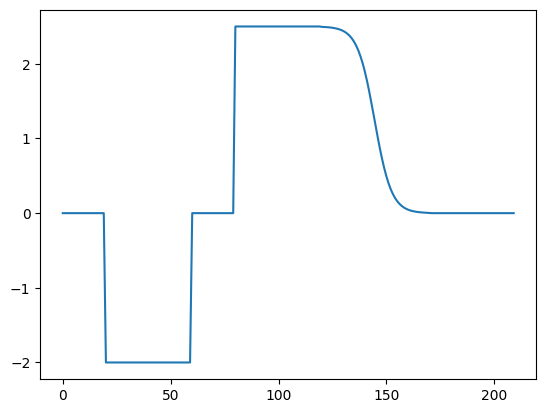

In [8]:
# path = ''
# data = pd.read_pickle(path + 'open_loop_data_SISO.pkl')

# data["y"][1:] = data["y"][0:-1]
# Ref_traj = data["y"].values*3.1
# Ref_traj = np.concatenate((np.zeros((3)),Ref_traj))


# Ref_traj = np.repeat(np.array([0,0,2,3.2,-1,-3.5,2,-3,-3.6,2,3.5]),10)

# Define the sigmoid function
def sigmoidd(x):
    return 1 / (1 + np.exp(-x/4))

# Generate x values from 0 to 29
x = np.linspace(0, 50, 50)

# Define the scaling parameters
a = 2.5 - 0 # Difference between upper bound and lower bound
b = 0  # Lower bound

# Compute the sigmoid values, scale, and shift them
y = -sigmoidd(x-25) * a + 2.5


# Ref_traj = np.repeat(np.array([0,-2,-2.5,-3,-3.9,-4,-3.3,-3,-2,0,1,2,3,3.9,4,3,2,0]),20)
Ref_traj = torch.tensor(np.repeat(np.array([0,-2,-2,0,2.5,2.5]),20))
smoothen = torch.tensor(y)
Ref_traj = torch.concatenate((Ref_traj,smoothen,torch.zeros(40)))

plt.plot(Ref_traj)


In [9]:
#  === Initial Conditions: Values at time = k ==================
torch.set_default_dtype(torch.float32)
u_hat = torch.zeros((P))
x_past = torch.zeros((2,window))
u_past = torch.zeros((1,window))
error_past = torch.zeros((2,window))
x_current = torch.zeros((2,1))
x_sys_current = x_current
x_hat_current = x_current

K_ac = torch.tensor([[-0.2068,-0.6756]])*0.3


RobustMPC = RMPC_pytorch_iteration(u_hat=u_hat,
                     x_past=x_past,
                     u_past=u_past,
                     window=window,
                     P=P,
                     x_current=x_current,
                     K_ac=K_ac,
                     sys_params=nominal_params,
                     optim_obj=RMPC_obj_TiDE_pytorch_w_x,
                     penalty_obj = penalty_obj_w_x,
                     include_u_hist=False,
                     NN_model = nominal_TiDE,
                     NN_forward=TiDE_forward,
                     LossParam = LossParam,
                     error_past=error_past,
                     constraint=x_constraint_check_w_x,
                     tube_model=tube_TiDE,
                     tube_params=tube_params,
                     u_tighten=True,
                     global_state = global_state
                     )

# Run MPC

n_steps = 190

for i in range(n_steps):
    SP_hat = Ref_traj[i:i+P]
    RobustMPC.run_one_step(SP_hat=SP_hat, RMPC=True)

# Plots    
RobustMPC.Plot_standard(Ref_traj,n_steps,plot_traj_steps=n_steps,show_constraints=True)
RobustMPC.Plot_input_output(show_constraint=True)


KeyboardInterrupt: 

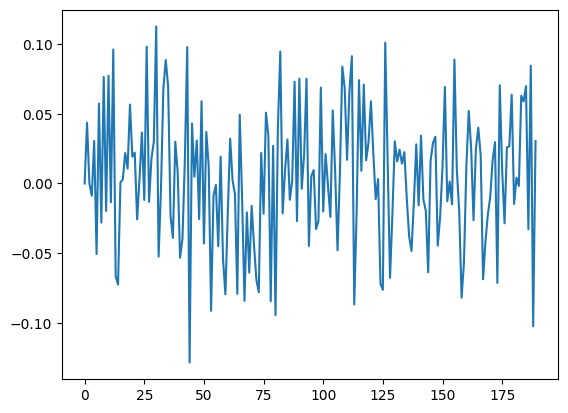

In [ ]:
plt.plot(RobustMPC.e_save[0,:])

In [ ]:
# from matplotlib.animation import FuncAnimation
# from IPython.display import HTML

# MPC_iters = n_steps

# # Set up the figure
# fig, ax = plt.subplots(figsize=(13.5, 6), dpi=100)
# ax.set_xlabel("Time",fontsize=14)
# ax.set_ylabel("x1",fontsize=14)
# plt.xlim(-1,MPC_iters + P)
# plt.ylim(-3,3)
# plt.plot(np.ones((n_steps,1))*2.5,'--',color='gray')
# plt.plot(np.ones((n_steps,1))*-2,'--',color='gray')


# Ref_traj_plot, = ax.plot(Ref_traj[:n_steps],'--', linewidth=1,color = 'black',label="Reference")
# real_output_plot, = ax.plot([],[], label="Output",color='blue',linewidth=2)
# point_current, = ax.plot([], [], ".", markersize=20, label="Current")
# line_pred, = ax.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
# line_true, = ax.plot([], [], "-", linewidth=1.5, color="green", label="True")

# ax.legend(loc='lower right', ncol=4)

# tube_x1 = ax.fill_between(np.linspace(0,P+1,P+1),np.zeros((P+1))*1,np.zeros((P+1))*1,alpha=0.3, label="Tube")

# # Function to update the plot in each iteration
# def update(iter):
#     real_output_plot.set_data(np.linspace(0, len(RobustMPC.real_output[0,:iter+1])-1, len(RobustMPC.real_output[0,:iter+1])), RobustMPC.real_output[0,:iter+1])
#     point_current.set_data(iter, RobustMPC.real_output[0,iter])
#     pred = np.concatenate((RobustMPC.real_output[0,iter].reshape(-1,1),RobustMPC.x_hat_horizon_save[iter,:].reshape(-1,1)),axis=0).flatten()
#     line_pred.set_data(np.linspace(iter,iter+P+1,P+1),pred)
#     line_true.set_data(np.linspace(iter,iter+P+1,P+1),np.concatenate((RobustMPC.real_output[0,iter].reshape(-1,1),RobustMPC.true_pred_output_x1_save[iter,:].reshape(-1,1)),axis=0))
#     tube_upper = np.concatenate((np.zeros((1,1)),RobustMPC.error_past_x1_upper[iter].reshape(-1,1)),axis=0).flatten()
#     tube_lower = np.concatenate((np.zeros((1,1)),RobustMPC.error_past_x1_lower[iter].reshape(-1,1)),axis=0).flatten()
#     ax.collections[-1].remove()
#     ax.fill_between(np.linspace(iter,iter+P+1,P+1),tube_upper+pred,tube_lower+pred,alpha=0.3, color='blue')
#     plt.title(f"Multi-step robust MPC in noisy environment")
#     return real_output_plot, point_current, line_pred, line_true
# # Create animation
# animation = FuncAnimation(fig, update, frames=MPC_iters,  blit=True)

# # # Show the animation
# HTML(animation.to_jshtml())
# plt.rcParams["animation.html"] = "jshtml"
# animation.save('vanilla_MPC_in_noisy_environment.gif', writer='imagemagick', fps=5)
# animation

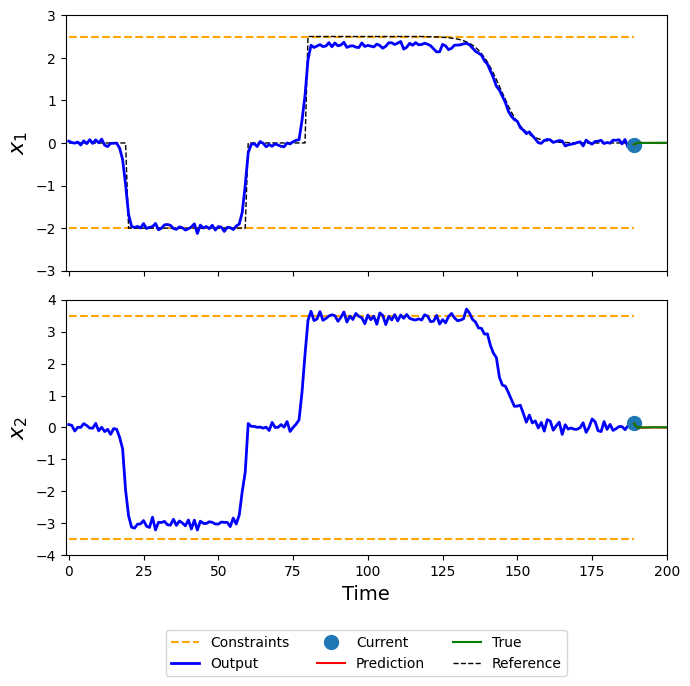

In [ ]:
# for vanilla MPC
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Assuming these variables are defined somewhere in your code:
# MPC_iters = n_steps
# P, Ref_traj, RobustMPC

MPC_iters = n_steps

# Set up the figure with two subplots sharing the same x-axis
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(7, 7), dpi=100, sharex=True)

# Adjust subplot parameters to remove the gap between subplots
plt.subplots_adjust(hspace=0.05)

# Configure ax1
ax1.set_ylabel("$x_1$", fontsize=16)
ax1.set_xlim(-1, MPC_iters + P)
ax1.set_ylim(-3, 3)
ax1.plot(np.ones((n_steps, 1)) * 2.5, '--', color='orange')
ax1.plot(np.ones((n_steps, 1)) * -2, '--', color='orange')
ax1.plot(Ref_traj[:n_steps], '--', linewidth=1, color='black', label="Reference")
#ax1.set_title(f"Multi-step robust MPC in noisy environment")

# Configure ax2
ax2.set_ylabel("$x_2$", fontsize=16)
ax2.set_xlim(-1, MPC_iters + P)
ax2.set_ylim(-4, 4)
ax2.plot(np.ones((n_steps, 1)) * 3.5, '--', color='orange')
ax2.plot(np.ones((n_steps, 1)) * -3.5, '--', color='orange',label="Constraints")
ax2.set_xlabel("Time", fontsize=14)

# Define plots for both subplots
real_output_plot1, = ax1.plot([], [], label="Output", color='blue', linewidth=2)
point_current1, = ax1.plot([], [], ".", markersize=20, label="Current")
line_pred1, = ax1.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true1, = ax1.plot([], [], "-", linewidth=1.5, color="green", label="True")


real_output_plot2, = ax2.plot([], [], label="Output", color='blue', linewidth=2)
point_current2, = ax2.plot([], [], ".", markersize=20, label="Current")
line_pred2, = ax2.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true2, = ax2.plot([], [], "-", linewidth=1.5, color="green", label="True")
ax2.plot([], '--', linewidth=1, color='black', label="Reference")
ax2.legend(loc='lower center',bbox_to_anchor=(0.5, -0.5), ncol=3)

plt.tight_layout()
# Global variables to store the collections


# Function to update the plots in each iteration
def update(iter):
    global tube_fill1, nominal_tube_fill1, tube_fill2, nominal_tube_fill2

    real_output_plot1.set_data(np.linspace(0, len(RobustMPC.real_output[0, :iter + 1]) - 1, len(RobustMPC.real_output[0, :iter + 1])), RobustMPC.real_output[0, :iter + 1])
    point_current1.set_data(iter, RobustMPC.real_output[0, iter])
    pred1 = np.concatenate((RobustMPC.real_output[0, iter].reshape(-1, 1), RobustMPC.x_hat_horizon_save[iter, :].reshape(-1, 1)), axis=0).flatten()
    line_pred1.set_data(np.linspace(iter, iter + P + 1, P + 1), pred1)
    line_true1.set_data(np.linspace(iter, iter + P + 1, P + 1), np.concatenate((RobustMPC.real_output[0, iter].reshape(-1, 1), RobustMPC.true_pred_output_x1_save[iter, :].reshape(-1, 1)), axis=0))
    

    real_output_plot2.set_data(np.linspace(0, len(RobustMPC.real_output[1, :iter + 1]) - 1, len(RobustMPC.real_output[1, :iter + 1])), RobustMPC.real_output[1, :iter + 1])
    point_current2.set_data(iter, RobustMPC.real_output[1, iter])
    pred2 = np.concatenate((RobustMPC.real_output[1, iter].reshape(-1, 1), RobustMPC.x2_hat_horizon_save[iter, :].reshape(-1, 1)), axis=0).flatten()
    line_pred2.set_data(np.linspace(iter, iter + P + 1, P + 1), pred2)
    line_true2.set_data(np.linspace(iter, iter + P + 1, P + 1), np.concatenate((RobustMPC.real_output[1, iter].reshape(-1, 1), RobustMPC.true_pred_output_x2_save[iter, :].reshape(-1, 1)), axis=0))
    
    
    return [real_output_plot1, point_current1, line_pred1, line_true1, real_output_plot2, point_current2, line_pred2, line_true2]

# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters, blit=True)

# Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('vanilla_MPC_in_noisy_environment.gif', writer='imagemagick', fps=10)
animation


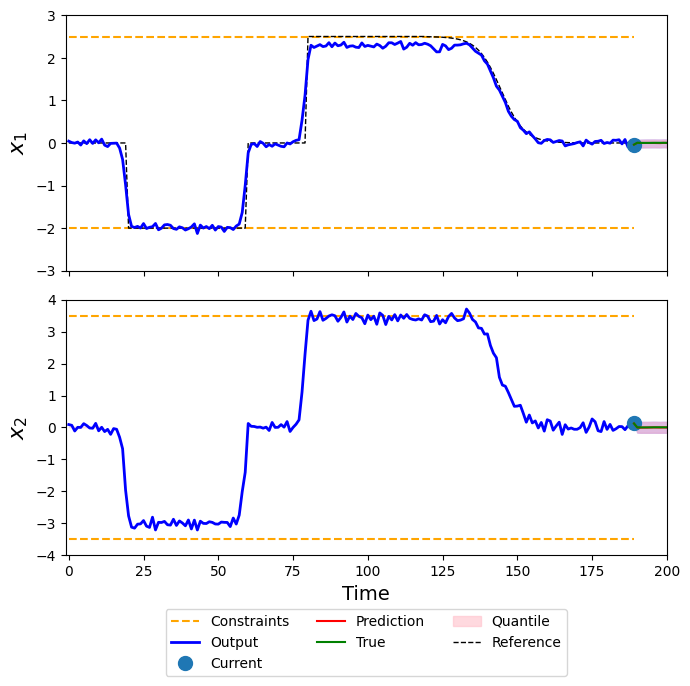

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Assuming these variables are defined somewhere in your code:
# MPC_iters = n_steps
# P, Ref_traj, RobustMPC

MPC_iters = n_steps

# Set up the figure with two subplots sharing the same x-axis
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(7, 7), dpi=100, sharex=True)

# Adjust subplot parameters to remove the gap between subplots
plt.subplots_adjust(hspace=0.05)

# Configure ax1
ax1.set_ylabel("$x_1$", fontsize=16)
ax1.set_xlim(-1, MPC_iters + P)
ax1.set_ylim(-3, 3)
ax1.plot(np.ones((n_steps, 1)) * 2.5, '--', color='orange')
ax1.plot(np.ones((n_steps, 1)) * -2, '--', color='orange')
ax1.plot(Ref_traj[:n_steps], '--', linewidth=1, color='black', label="Reference")
#ax1.set_title(f"Multi-step robust MPC in noisy environment")

# Configure ax2
ax2.set_ylabel("$x_2$", fontsize=16)
ax2.set_xlim(-1, MPC_iters + P)
ax2.set_ylim(-4, 4)
ax2.plot(np.ones((n_steps, 1)) * 3.5, '--', color='orange')
ax2.plot(np.ones((n_steps, 1)) * -3.5, '--', color='orange',label="Constraints")
ax2.set_xlabel("Time", fontsize=14)

# Define plots for both subplots
real_output_plot1, = ax1.plot([], [], label="Output", color='blue', linewidth=2)
point_current1, = ax1.plot([], [], ".", markersize=20, label="Current")
line_pred1, = ax1.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true1, = ax1.plot([], [], "-", linewidth=1.5, color="green", label="True")
tube_x1_1 = ax1.fill_between(np.linspace(0, P + 1, P + 1), np.zeros((P + 1)) * 1, np.zeros((P + 1)) * 1, alpha=0.3, label="Tube")

real_output_plot2, = ax2.plot([], [], label="Output", color='blue', linewidth=2)
point_current2, = ax2.plot([], [], ".", markersize=20, label="Current")
line_pred2, = ax2.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true2, = ax2.plot([], [], "-", linewidth=1.5, color="green", label="True")
#tube_x1_2 = ax2.fill_between(np.linspace(0, P + 1, P + 1), np.zeros((P + 1)) * 1, np.zeros((P + 1)) * 1, alpha=0.3, label="Distrubance quantile")
tube_x1_nominal = ax2.fill_between(np.linspace(0, P + 1, P + 1), np.zeros((P + 1)) * 1, np.zeros((P + 1)) * 1, alpha=0.6, color='pink', label="Quantile")
ax2.plot([], '--', linewidth=1, color='black', label="Reference")
ax2.legend(loc='lower center',bbox_to_anchor=(0.5, -0.5), ncol=3)

plt.tight_layout()
# Global variables to store the collections
tube_fill1 = None
nominal_tube_fill1 = None
tube_fill2 = None
nominal_tube_fill2 = None

# Function to update the plots in each iteration
def update(iter):
    global tube_fill1, nominal_tube_fill1, tube_fill2, nominal_tube_fill2

    real_output_plot1.set_data(np.linspace(0, len(RobustMPC.real_output[0, :iter + 1]) - 1, len(RobustMPC.real_output[0, :iter + 1])), RobustMPC.real_output[0, :iter + 1])
    point_current1.set_data(iter, RobustMPC.real_output[0, iter])
    pred1 = np.concatenate((RobustMPC.real_output[0, iter].reshape(-1, 1), RobustMPC.x_hat_horizon_save[iter, :].reshape(-1, 1)), axis=0).flatten()
    line_pred1.set_data(np.linspace(iter, iter + P + 1, P + 1), pred1)
    line_true1.set_data(np.linspace(iter, iter + P + 1, P + 1), np.concatenate((RobustMPC.real_output[0, iter].reshape(-1, 1), RobustMPC.true_pred_output_x1_save[iter, :].reshape(-1, 1)), axis=0))
    
    tube_upper1 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x1_upper[iter].reshape(-1, 1)), axis=0).flatten()
    tube_lower1 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x1_lower[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_upper1 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x1_upper_quantile[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_lower1 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x1_lower_quantile[iter].reshape(-1, 1)), axis=0).flatten()

    # Remove previous fill_between collections if they exist
    if tube_fill1:
        tube_fill1.remove()
    if nominal_tube_fill1:
        nominal_tube_fill1.remove()
    
    tube_fill1 = ax1.fill_between(np.linspace(iter, iter + P + 1, P + 1), tube_upper1 + pred1, tube_lower1 + pred1, alpha=0.3, color='blue')
    nominal_tube_fill1 = ax1.fill_between(np.linspace(iter, iter + P + 1, P + 1), nominal_tube_upper1 + pred1, nominal_tube_lower1 + pred1, alpha=0.6, color='pink')

    real_output_plot2.set_data(np.linspace(0, len(RobustMPC.real_output[1, :iter + 1]) - 1, len(RobustMPC.real_output[1, :iter + 1])), RobustMPC.real_output[1, :iter + 1])
    point_current2.set_data(iter, RobustMPC.real_output[1, iter])
    pred2 = np.concatenate((RobustMPC.real_output[1, iter].reshape(-1, 1), RobustMPC.x2_hat_horizon_save[iter, :].reshape(-1, 1)), axis=0).flatten()
    line_pred2.set_data(np.linspace(iter, iter + P + 1, P + 1), pred2)
    line_true2.set_data(np.linspace(iter, iter + P + 1, P + 1), np.concatenate((RobustMPC.real_output[1, iter].reshape(-1, 1), RobustMPC.true_pred_output_x2_save[iter, :].reshape(-1, 1)), axis=0))
    
    tube_upper2 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x2_upper[iter].reshape(-1, 1)), axis=0).flatten()
    tube_lower2 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x2_lower[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_upper2 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x2_upper_quantile[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_lower2 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x2_lower_quantile[iter].reshape(-1, 1)), axis=0).flatten()
    
    # Remove previous fill_between collections if they exist
    if tube_fill2:
        tube_fill2.remove()
    if nominal_tube_fill2:
        nominal_tube_fill2.remove()
    
    tube_fill2 = ax2.fill_between(np.linspace(iter, iter + P + 1, P + 1), tube_upper2 + pred2, tube_lower2 + pred2, alpha=0.3, color='blue')
    nominal_tube_fill2 = ax2.fill_between(np.linspace(iter, iter + P + 1, P + 1), nominal_tube_upper2 + pred2, nominal_tube_lower2 + pred2, alpha=0.6, color='pink')
    
    return [real_output_plot1, point_current1, line_pred1, line_true1, real_output_plot2, point_current2, line_pred2, line_true2]

# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters, blit=True)

# Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('robust_MPC_in_noisy_environment_MPC_UQ.gif', writer='imagemagick', fps=10)
animation


#### Save iterative data

In [ ]:
v1 = RobustMPC.error_past_x1_upper
v2 = RobustMPC.error_past_x1_lower
v3 = RobustMPC.error_past_x2_upper
v4 = RobustMPC.error_past_x2_lower
v5 = RobustMPC.x_hat_horizon_save
v6 = RobustMPC.true_pred_output_x1_save
v7 = RobustMPC.x2_hat_horizon_save
v8 = RobustMPC.true_pred_output_x2_save

combined = torch.hstack([v1,v2,v3,v4,v5,v6,v7,v8]).numpy()
df = pd.DataFrame(combined)
df.to_csv("data_each_Step.csv",index = False, header = False)

#### Save time series data

In [ ]:
ref_save = Ref_traj[:n_steps].reshape(-1,1)
real_output_save = RobustMPC.real_output.transpose(1,0)
u_nominal_save = RobustMPC.nominal_u
u_applied_save = RobustMPC.u_applied_save

combined = torch.hstack([ref_save,real_output_save,u_nominal_save,u_applied_save]).numpy()
df = pd.DataFrame(combined)
df.to_csv("whole_traj.csv",index = False, header = False)


KeyboardInterrupt: 

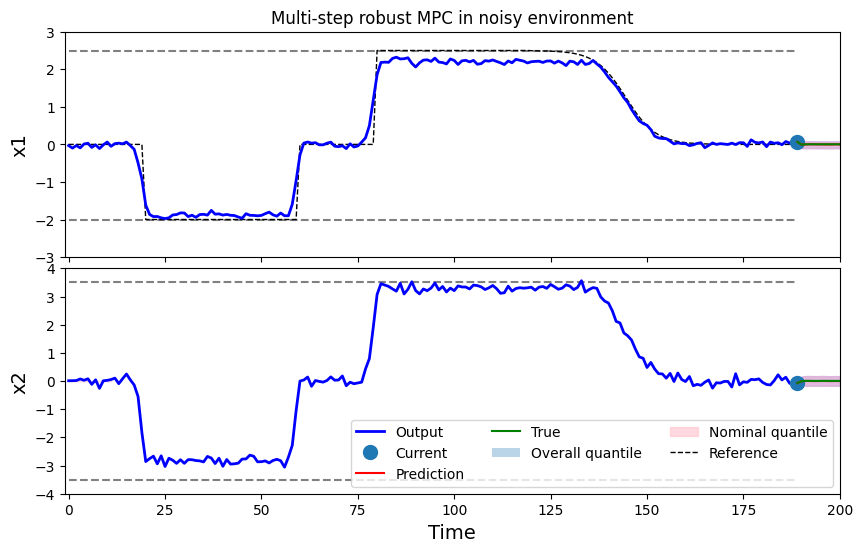

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Assuming these variables are defined somewhere in your code:
# MPC_iters = n_steps
# P, Ref_traj, RobustMPC

MPC_iters = n_steps

# Set up the figure with two subplots sharing the same x-axis
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 6), dpi=100, sharex=True)

# Adjust subplot parameters to remove the gap between subplots
plt.subplots_adjust(hspace=0.05)

# Configure ax1
ax1.set_ylabel("x1", fontsize=14)
ax1.set_xlim(-1, MPC_iters + P)
ax1.set_ylim(-3, 3)
ax1.plot(np.ones((n_steps, 1)) * 2.5, '--', color='gray')
ax1.plot(np.ones((n_steps, 1)) * -2, '--', color='gray')
ax1.plot(Ref_traj[:n_steps], '--', linewidth=1, color='black', label="Reference")
ax1.set_title(f"Multi-step robust MPC in noisy environment")

# Configure ax2
ax2.set_ylabel("x2", fontsize=14)
ax2.set_xlim(-1, MPC_iters + P)
ax2.set_ylim(-4, 4)
ax2.plot(np.ones((n_steps, 1)) * 3.5, '--', color='gray')
ax2.plot(np.ones((n_steps, 1)) * -3.5, '--', color='gray')
ax2.set_xlabel("Time", fontsize=14)

# Define plots for both subplots
real_output_plot1, = ax1.plot([], [], label="Output", color='blue', linewidth=2)
point_current1, = ax1.plot([], [], ".", markersize=20, label="Current")
line_pred1, = ax1.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true1, = ax1.plot([], [], "-", linewidth=1.5, color="green", label="True")
tube_x1_1 = ax1.fill_between(np.linspace(0, P + 1, P + 1), np.zeros((P + 1)) * 1, np.zeros((P + 1)) * 1, alpha=0.3, label="Tube")

real_output_plot2, = ax2.plot([], [], label="Output", color='blue', linewidth=2)
point_current2, = ax2.plot([], [], ".", markersize=20, label="Current")
line_pred2, = ax2.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true2, = ax2.plot([], [], "-", linewidth=1.5, color="green", label="True")
tube_x1_2 = ax2.fill_between(np.linspace(0, P + 1, P + 1), np.zeros((P + 1)) * 1, np.zeros((P + 1)) * 1, alpha=0.3, label="Overall quantile")
tube_x1_nominal = ax2.fill_between(np.linspace(0, P + 1, P + 1), np.zeros((P + 1)) * 1, np.zeros((P + 1)) * 1, alpha=0.6, color='pink', label="Nominal quantile")
ax2.plot([], '--', linewidth=1, color='black', label="Reference")
ax2.legend(loc='lower right', ncol=3)

# Global variables to store the collections
tube_fill1 = None
nominal_tube_fill1 = None
tube_fill2 = None
nominal_tube_fill2 = None

# Function to update the plots in each iteration
def update(iter):
    global tube_fill1, nominal_tube_fill1, tube_fill2, nominal_tube_fill2

    real_output_plot1.set_data(np.linspace(0, len(RobustMPC.real_output[0, :iter + 1]) - 1, len(RobustMPC.real_output[0, :iter + 1])), RobustMPC.real_output[0, :iter + 1])
    point_current1.set_data(iter, RobustMPC.real_output[0, iter])
    pred1 = np.concatenate((RobustMPC.real_output[0, iter].reshape(-1, 1), RobustMPC.x_hat_horizon_save[iter, :].reshape(-1, 1)), axis=0).flatten()
    line_pred1.set_data(np.linspace(iter, iter + P + 1, P + 1), pred1)
    line_true1.set_data(np.linspace(iter, iter + P + 1, P + 1), np.concatenate((RobustMPC.real_output[0, iter].reshape(-1, 1), RobustMPC.true_pred_output_x1_save[iter, :].reshape(-1, 1)), axis=0))
    
    tube_upper1 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x1_upper[iter].reshape(-1, 1)), axis=0).flatten()
    tube_lower1 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x1_lower[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_upper1 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x1_upper_quantile[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_lower1 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x1_lower_quantile[iter].reshape(-1, 1)), axis=0).flatten()

    # Remove previous fill_between collections if they exist
    if tube_fill1:
        tube_fill1.remove()
    if nominal_tube_fill1:
        nominal_tube_fill1.remove()
    
    tube_fill1 = ax1.fill_between(np.linspace(iter, iter + P + 1, P + 1), tube_upper1 + pred1, tube_lower1 + pred1, alpha=0.3, color='blue')
    nominal_tube_fill1 = ax1.fill_between(np.linspace(iter, iter + P + 1, P + 1), nominal_tube_upper1 + pred1, nominal_tube_lower1 + pred1, alpha=0.6, color='pink')

    real_output_plot2.set_data(np.linspace(0, len(RobustMPC.real_output[1, :iter + 1]) - 1, len(RobustMPC.real_output[1, :iter + 1])), RobustMPC.real_output[1, :iter + 1])
    point_current2.set_data(iter, RobustMPC.real_output[1, iter])
    pred2 = np.concatenate((RobustMPC.real_output[1, iter].reshape(-1, 1), RobustMPC.x2_hat_horizon_save[iter, :].reshape(-1, 1)), axis=0).flatten()
    line_pred2.set_data(np.linspace(iter, iter + P + 1, P + 1), pred2)
    line_true2.set_data(np.linspace(iter, iter + P + 1, P + 1), np.concatenate((RobustMPC.real_output[1, iter].reshape(-1, 1), RobustMPC.true_pred_output_x2_save[iter, :].reshape(-1, 1)), axis=0))
    
    tube_upper2 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x2_upper[iter].reshape(-1, 1)), axis=0).flatten()
    tube_lower2 = np.concatenate((np.zeros((1, 1)), RobustMPC.error_past_x2_lower[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_upper2 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x2_upper_quantile[iter].reshape(-1, 1)), axis=0).flatten()
    nominal_tube_lower2 = np.concatenate((np.zeros((1, 1)), RobustMPC.nominal_x2_lower_quantile[iter].reshape(-1, 1)), axis=0).flatten()
    
    # Remove previous fill_between collections if they exist
    if tube_fill2:
        tube_fill2.remove()
    if nominal_tube_fill2:
        nominal_tube_fill2.remove()
    
    tube_fill2 = ax2.fill_between(np.linspace(iter, iter + P + 1, P + 1), tube_upper2 + pred2, tube_lower2 + pred2, alpha=0.3, color='blue')
    nominal_tube_fill2 = ax2.fill_between(np.linspace(iter, iter + P + 1, P + 1), nominal_tube_upper2 + pred2, nominal_tube_lower2 + pred2, alpha=0.6, color='pink')
    
    return [real_output_plot1, point_current1, line_pred1, line_true1, real_output_plot2, point_current2, line_pred2, line_true2]

# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters, blit=True)

# Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('robust_MPC_in_noisy_environment_full_UQ.gif', writer='imagemagick', fps=5)
animation


## Loop through RMPC

In [ ]:
n_iter = 1000
n_steps = 190

x1_save = []
x2_save = []

for j in tqdm(range(n_iter)): 

    #  === Initial Conditions: Values at time = k ==================
    torch.set_default_dtype(torch.float32)
    u_hat = torch.zeros((P))
    x_past = torch.zeros((2,window))
    u_past = torch.zeros((1,window))
    error_past = torch.zeros((2,window))
    x_current = torch.zeros((2,1))
    x_sys_current = x_current
    x_hat_current = x_current

    K_ac = torch.tensor([[-0.2068,-0.6756]])*0.3


    RobustMPC = RMPC_pytorch_iteration(u_hat=u_hat,
                        x_past=x_past,
                        u_past=u_past,
                        window=window,
                        P=P,
                        x_current=x_current,
                        K_ac=K_ac,
                        sys_params=nominal_params,
                        optim_obj=RMPC_obj_TiDE_pytorch_w_x,
                        penalty_obj = penalty_obj_w_x,
                        include_u_hist=False,
                        NN_model = nominal_TiDE,
                        NN_forward=TiDE_forward,
                        LossParam = LossParam,
                        error_past=error_past,
                        constraint=x_constraint_check_w_x,
                        tube_model=tube_TiDE,
                        tube_params=tube_params,
                        u_tighten=True,
                        global_state = global_state
                        )

    # Run MPC


    for i in range(n_steps):
        SP_hat = Ref_traj[i:i+P]
        RobustMPC.run_one_step(SP_hat=SP_hat, RMPC=True)

    try:
        x1_save = torch.concatenate((x1_save, RobustMPC.real_output[0,:].reshape(1,-1)),dim=0)
        x2_save = torch.concatenate((x2_save, RobustMPC.real_output[1,:].reshape(1,-1)),dim=0)
    except:
        x1_save = RobustMPC.real_output[0,:].reshape(1,-1)
        x2_save = RobustMPC.real_output[1,:].reshape(1,-1)
    
    
# Define the file path
file_path = 'x1_save_nominal_quantile.csv'
import os
# Check if the file exists and delete it if it does
if os.path.exists(file_path):
    os.remove(file_path)# Define the file path
    
file_path = 'x2_save_nominal_quantile.csv'

# Check if the file exists and delete it if it does
if os.path.exists(file_path):
    os.remove(file_path)
    
        
np.savetxt('x1_save_nominal_quantile.csv', x1_save.numpy(), delimiter=',')
np.savetxt('x2_save_nominal_quantile.csv', x2_save.numpy(), delimiter=',')

  0%|          | 0/1000 [00:00<?, ?it/s]

In [ ]:
current_directory = os.getcwd()
file_name = 'x1_save_nominal_quantile.csv'
save_path = os.path.join(current_directory, file_name)
np.savetxt(save_path, x1_save.numpy(), delimiter=',')

current_directory = os.getcwd()
file_name = 'x2_save_nominal_quantile.csv'
save_path = os.path.join(current_directory, file_name)
np.savetxt(save_path, x2_save.numpy(), delimiter=',')

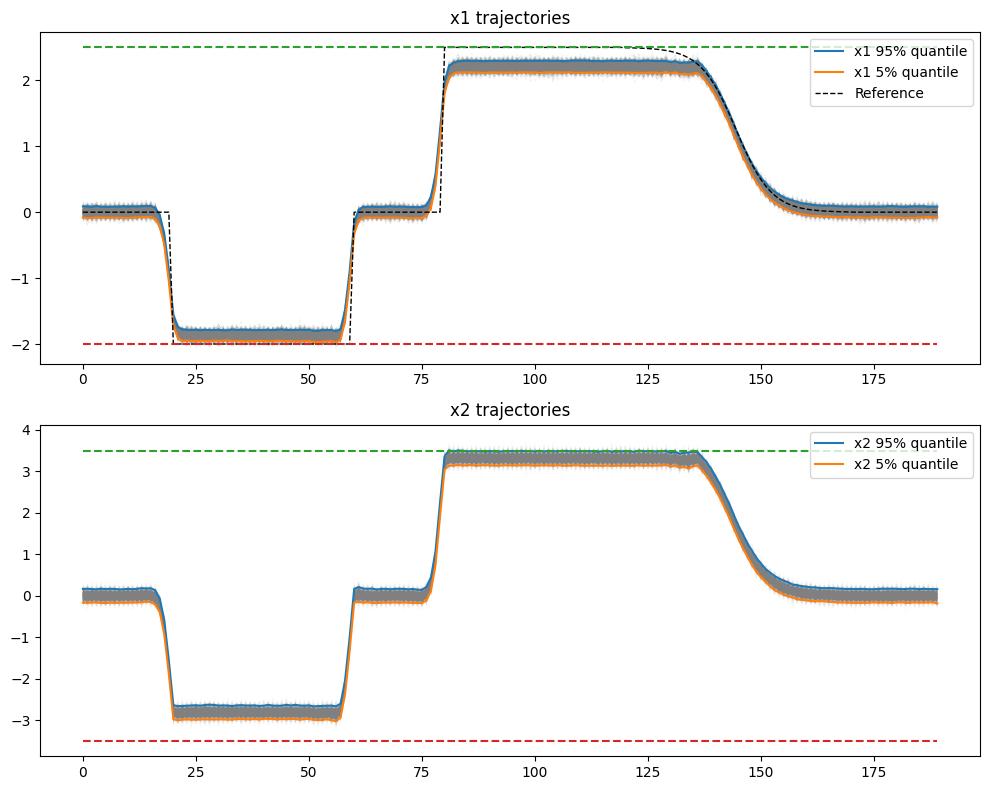

In [ ]:
# find quantile
# new_arr2 = x2_save[~np.ma.fix_invalid(x2_save).mask.any(axis=1)]
# new_arr1 = x1_save[~np.ma.fix_invalid(x2_save).mask.any(axis=1)]

new_arr2 = x2_save
new_arr1 = x1_save

x1_quantile = np.nanquantile(new_arr1, [0.05,0.95],axis=0)
x2_quantile = np.nanquantile(new_arr2, [0.05,0.95],axis=0)


fig, axs = plt.subplots(2, 1, figsize=(10, 8))

# Plot for x1_save
for i in range(n_iter):
    axs[0].plot(x1_save[i].numpy(),color="gray",linewidth=0.05)

axs[0].plot(x1_quantile[1,:], label="x1 95% quantile")
axs[0].plot(x1_quantile[0,:], label="x1 5% quantile")
axs[0].plot(Ref_traj[:n_steps], '--', linewidth=1, color='black', label="Reference")
axs[0].set_title('x1 trajectories')
axs[0].legend()

# Plot for x2_save
for i in range(n_iter):
    axs[1].plot(x2_save[i].numpy(),color="gray",linewidth=0.01)

axs[1].plot(x2_quantile[1,:], label="x2 95% quantile")
axs[1].plot(x2_quantile[0,:], label="x2 5% quantile")
axs[1].set_title('x2 trajectories')
axs[1].legend()

axs[0].plot(np.ones_like(x1_save[i])*2.5,"--", label="x1 upper bound")
axs[0].plot(np.ones_like(x1_save[i])*-2,"--", label="x1 lower bound")

axs[1].plot(np.ones_like(x2_save[i])*3.5,"--", label="x2 upper bound")
axs[1].plot(np.ones_like(x2_save[i])*-3.5,"--", label="x2 lower bound")
plt.tight_layout()
plt.show()

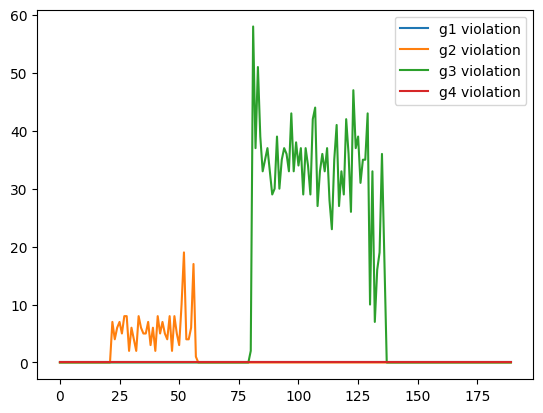

In [ ]:
g1_violate = np.empty((n_steps))
g2_violate = np.empty((n_steps))
g3_violate = np.empty((n_steps))
g4_violate = np.empty((n_steps))


for i in range(n_steps):
    x1_instant = np.array(x1_save[:,i])
    x2_instant = np.array(x2_save[:,i])
    
    g1_violate[i] = np.sum(x1_instant - 2.5 >= 0)
    g2_violate[i] = np.sum(-2 - x1_instant >= 0)
    g3_violate[i] = np.sum(x2_instant - 3.5 >= 0)
    g4_violate[i] = np.sum(-3.5 - x2_instant >= 0)

plt.figure()
plt.plot(g1_violate, label="g1 violation")
plt.plot(g2_violate, label="g2 violation")
plt.plot(g3_violate, label="g3 violation")
plt.plot(g4_violate, label="g4 violation")
plt.legend()

### MPC without constraint

In [ ]:
#  === Initial Conditions: Values at time = k ==================
u_hat = np.zeros((P))
x_past = np.zeros((2,window))
u_past = np.zeros((1,window))
error_past = np.zeros((2,window))
x_current = np.zeros((2,1))
x_sys_current = x_current
x_hat_current = x_current

K_ac = np.array([[-0.2068,-0.6756]])

vanilla_MPC = RMPC_iteration(u_hat=u_hat,
                     x_past=x_past,
                     u_past=u_past,
                     window=window,
                     P=P,
                     x_current=x_current,
                     K_ac=K_ac,
                     sys_params=nominal_params,
                     optim_obj=RMPC_obj_TiDE,
                     include_u_hist=False,
                     NN_model = nominal_TiDE,
                     NN_forward=TiDE_forward,
                     error_past=error_past,
                     constraint=None,
                     tube_model=tube_TiDE,
                     u_tighten=None
                     )


# Run MPC

n_steps = 120

for i in range(n_steps):
    SP_hat = Ref_traj[i:i+P]
    vanilla_MPC.run_one_step(SP_hat=SP_hat)

# Plots    
vanilla_MPC.Plot_standard(Ref_traj,n_steps,plot_traj_steps=n_steps,show_constraints=True)
vanilla_MPC.Plot_input_output(show_constraint=True)


from matplotlib.animation import FuncAnimation
from IPython.display import HTML

MPC_iters = n_steps

# Set up the figure
fig, ax = plt.subplots(figsize=(9, 4), dpi=100)
ax.set_xlabel("Time",fontsize=14)
ax.set_ylabel("x1",fontsize=14)
plt.xlim(-1,MPC_iters + P)
plt.ylim(-3,3)
plt.plot(np.ones((n_steps,1))*1,'--',color='gray')
plt.plot(np.ones((n_steps,1))*-1,'--',color='gray')


Ref_traj_plot, = ax.plot(Ref_traj[:n_steps],'--', linewidth=1,color = 'black',label="Reference")
real_output_plot, = ax.plot([],[], label="Output",color='blue',linewidth=2)
point_current, = ax.plot([], [], ".", markersize=20, label="Current")
line_pred, = ax.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true, = ax.plot([], [], "-", linewidth=1.5, color="green", label="True")

ax.legend(loc='lower right', ncol=4)


# Function to update the plot in each iteration
def update(iter):
    real_output_plot.set_data(np.linspace(0, len(vanilla_MPC.real_output[0,:iter])-1, len(vanilla_MPC.real_output[0,:iter])), vanilla_MPC.real_output[0,:iter])
    point_current.set_data(iter, vanilla_MPC.real_output[0,iter])
    pred = np.concatenate((vanilla_MPC.real_output[0,iter].reshape(-1,1),vanilla_MPC.x_hat_horizon_save[iter,:].reshape(-1,1)),axis=0).flatten()
    line_pred.set_data(np.linspace(iter,iter+P+1,P+1),pred)
    line_true.set_data(np.linspace(iter,iter+P+1,P+1),np.concatenate((vanilla_MPC.real_output[0,iter].reshape(-1,1),vanilla_MPC.true_pred_output_x1_save[iter,:].reshape(-1,1)),axis=0))

    plt.title(f"Multi-step vanilla MPC in noisy environment")
    return real_output_plot, point_current, line_pred, line_true
# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters,  blit=True)

# # Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('vanilla_MPC_in_noisy_environment.gif', writer='imagemagick', fps=5)
animation

NameError: name 'RMPC_obj_TiDE' is not defined

### MPC with constraint and tube

In [ ]:
import random

# Set a random seed
random_seed = 513 # 43  # You can use any integer value as the seed
random.seed(random_seed)

#  === Initial Conditions: Values at time = k ==================
u_hat = np.zeros((P))
x_past = np.zeros((2,window))
u_past = np.zeros((1,window))
error_past = np.zeros((2,window))
x_current = np.zeros((2,1))
x_sys_current = x_current
x_hat_current = x_current

K_ac = np.array([[-0.2068,-0.6756]])

MPC_w_constraint_tube = RMPC_iteration(u_hat=u_hat,
                     x_past=x_past,
                     u_past=u_past,
                     window=window,
                     P=P,
                     x_current=x_current,
                     K_ac=K_ac,
                     sys_params=nominal_params,
                     optim_obj=RMPC_obj_TiDE,
                     include_u_hist=False,
                     NN_model = nominal_TiDE,
                     NN_forward=TiDE_forward,
                     error_past=error_past,
                     constraint=x_bound_check_wrapper,
                     tube_model=tube_TiDE,
                     u_tighten=True
                     )


# Run MPC

n_steps = 120

for i in range(n_steps):
    SP_hat = Ref_traj[i:i+P]
    MPC_w_constraint_tube.run_one_step(SP_hat=SP_hat)

# Plots    
MPC_w_constraint_tube.Plot_standard(Ref_traj,n_steps,plot_traj_steps=n_steps,show_constraints=True)
MPC_w_constraint_tube.Plot_input_output(show_constraint=True)

ValueError: all the input array dimensions except for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 10 and the array at index 1 has size 1

In [ ]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

MPC_iters = n_steps

# Set up the figure
fig, ax = plt.subplots(figsize=(9, 4), dpi=100)
ax.set_xlabel("Time",fontsize=14)
ax.set_ylabel("x1",fontsize=14)
plt.xlim(-1,MPC_iters + P)
plt.ylim(-5,5)
plt.plot(np.ones((n_steps,1))*4,'--',color='gray')
plt.plot(np.ones((n_steps,1))*-4,'--',color='gray')


Ref_traj_plot, = ax.plot(Ref_traj[:n_steps],'--', linewidth=1,color = 'black',label="Reference")
real_output_plot, = ax.plot([],[], label="Output",color='blue',linewidth=2)
point_current, = ax.plot([], [], ".", markersize=20, label="Current")
line_pred, = ax.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true, = ax.plot([], [], "-", linewidth=1.5, color="green", label="True")


tube_x1 = ax.fill_between(np.linspace(0,P+1,P+1),np.zeros((P+1))*1,np.zeros((P+1))*1,alpha=0.3, label="Tube")

ax.legend(loc='lower right', ncol=4)


# Function to update the plot in each iteration
def update(iter):
    real_output_plot.set_data(np.linspace(0, len(MPC_w_constraint_tube.real_output[0,:iter])-1, len(MPC_w_constraint_tube.real_output[0,:iter])), MPC_w_constraint_tube.real_output[0,:iter])
    point_current.set_data(iter, MPC_w_constraint_tube.real_output[0,iter])
    pred = np.concatenate((MPC_w_constraint_tube.real_output[0,iter].reshape(-1,1),MPC_w_constraint_tube.x_hat_horizon_save[iter,:].reshape(-1,1)),axis=0).flatten()
    line_pred.set_data(np.linspace(iter,iter+P+1,P+1),pred)
    line_true.set_data(np.linspace(iter,iter+P+1,P+1),np.concatenate((MPC_w_constraint_tube.real_output[0,iter].reshape(-1,1),MPC_w_constraint_tube.true_pred_output_x1_save[iter,:].reshape(-1,1)),axis=0))
    tube_upper = np.concatenate((np.zeros((1,1)),MPC_w_constraint_tube.error_past_x1_upper[iter].reshape(-1,1)),axis=0).flatten()
    tube_lower = np.concatenate((np.zeros((1,1)),MPC_w_constraint_tube.error_past_x1_lower[iter].reshape(-1,1))).flatten()
    ax.collections[-1].remove()
    ax.fill_between(np.linspace(iter,iter+P+1,P+1),tube_upper+pred,tube_lower+pred,alpha=0.3, color='blue')
    plt.title(f"step {iter}")
    return real_output_plot, point_current, line_pred, line_true
# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters,  blit=True)

# # Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('animation_with_correct_tubes.gif', writer='imagemagick', fps=5)
animation

### MPC with constraint without tube

In [ ]:
import random

# Set a random seed
random_seed = 43  # You can use any integer value as the seed
random.seed(random_seed)

#  === Initial Conditions: Values at time = k ==================
u_hat = np.zeros((P))
x_past = np.zeros((2,window))
u_past = np.zeros((1,window))
error_past = np.zeros((2,window))
x_current = np.zeros((2,1))
x_sys_current = x_current
x_hat_current = x_current

K_ac = np.array([[-0.2068,-0.6756]])

MPC_w_constraint_no_tube = RMPC_iteration(u_hat=u_hat,
                     x_past=x_past,
                     u_past=u_past,
                     window=window,
                     P=P,
                     x_current=x_current,
                     K_ac=K_ac,
                     sys_params=nominal_params,
                     optim_obj=RMPC_obj_TiDE,
                     include_u_hist=False,
                     NN_model = nominal_TiDE,
                     NN_forward=TiDE_forward,
                     error_past=error_past,
                     constraint=x_bound_check_wrapper_wo_tube,
                     tube_model=tube_TiDE,
                     u_tighten=None
                     )


# Run MPC

n_steps = 120

for i in range(n_steps):
    SP_hat = Ref_traj[i:i+P]
    MPC_w_constraint_no_tube.run_one_step(SP_hat=SP_hat)

# Plots    
MPC_w_constraint_no_tube.Plot_standard(Ref_traj,n_steps,plot_traj_steps=n_steps,show_constraints=True)
MPC_w_constraint_no_tube.Plot_input_output(show_constraint=True)

## MPC with soft constraint penalty

In [ ]:
import random

# Set a random seed
random_seed = 513 # 43  # You can use any integer value as the seed
random.seed(random_seed)

#  === Initial Conditions: Values at time = k ==================
u_hat = np.zeros((P))
x_past = np.zeros((2,window))
u_past = np.zeros((1,window))
error_past = np.zeros((2,window))
x_current = np.zeros((2,1))
x_sys_current = x_current
x_hat_current = x_current

K_ac = np.array([[-0.2068,-0.6756]])

MPC_w_penalty_tube = RMPC_iteration(u_hat=u_hat,
                     x_past=x_past,
                     u_past=u_past,
                     window=window,
                     P=P,
                     x_current=x_current,
                     K_ac=K_ac,
                     sys_params=nominal_params,
                     optim_obj=RMPC_obj_TiDE_w_penalty,
                     include_u_hist=False,
                     NN_model = nominal_TiDE,
                     NN_forward=TiDE_forward,
                     error_past=error_past,
                     constraint=None,
                     tube_model=tube_TiDE,
                     u_tighten=True
                     )


# Run MPC

n_steps = 120

for i in range(n_steps):
    SP_hat = Ref_traj[i:i+P]
    MPC_w_penalty_tube.run_one_step_w_penalty(SP_hat=SP_hat)

# Plots    
MPC_w_penalty_tube.Plot_standard(Ref_traj,n_steps,plot_traj_steps=n_steps,show_constraints=True)
MPC_w_penalty_tube.Plot_input_output(show_constraint=True)

In [ ]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

MPC_iters = n_steps

# Set up the figure
fig, ax = plt.subplots(figsize=(9, 4), dpi=100)
ax.set_xlabel("Time",fontsize=14)
ax.set_ylabel("x1",fontsize=14)
plt.xlim(-1,MPC_iters + P)
plt.ylim(-5,5)
plt.plot(np.ones((n_steps,1))*4,'--',color='gray')
plt.plot(np.ones((n_steps,1))*-4,'--',color='gray')


Ref_traj_plot, = ax.plot(Ref_traj[:n_steps],'--', linewidth=1,color = 'black',label="Reference")
real_output_plot, = ax.plot([],[], label="Output",color='blue',linewidth=2)
point_current, = ax.plot([], [], ".", markersize=20, label="Current")
line_pred, = ax.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true, = ax.plot([], [], "-", linewidth=1.5, color="green", label="True")


tube_x1 = ax.fill_between(np.linspace(0,P+1,P+1),np.zeros((P+1))*1,np.zeros((P+1))*1,alpha=0.3, label="Tube")

ax.legend(loc='lower right', ncol=4)


# Function to update the plot in each iteration
def update(iter):
    real_output_plot.set_data(np.linspace(0, len(MPC_w_penalty_tube.real_output[0,:iter])-1, len(MPC_w_penalty_tube.real_output[0,:iter])), MPC_w_penalty_tube.real_output[0,:iter])
    point_current.set_data(iter, MPC_w_penalty_tube.real_output[0,iter])
    pred = np.concatenate((MPC_w_penalty_tube.real_output[0,iter].reshape(-1,1),MPC_w_penalty_tube.x_hat_horizon_save[iter,:].reshape(-1,1)),axis=0).flatten()
    line_pred.set_data(np.linspace(iter,iter+P+1,P+1),pred)
    line_true.set_data(np.linspace(iter,iter+P+1,P+1),np.concatenate((MPC_w_penalty_tube.real_output[0,iter].reshape(-1,1),MPC_w_penalty_tube.true_pred_output_x1_save[iter,:].reshape(-1,1)),axis=0))
    tube_upper = np.concatenate((np.zeros((1,1)),MPC_w_penalty_tube.error_past_x1_upper[iter].reshape(-1,1)),axis=0).flatten()
    tube_lower = np.concatenate((np.zeros((1,1)),MPC_w_penalty_tube.error_past_x1_lower[iter].reshape(-1,1))).flatten()
    ax.collections[-1].remove()
    ax.fill_between(np.linspace(iter,iter+P+1,P+1),tube_upper+pred,tube_lower+pred,alpha=0.3, color='blue')
    plt.title(f"step {iter}")
    return real_output_plot, point_current, line_pred, line_true
# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters,  blit=True)

# # Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('animation_with_correct_tubes_penalty.gif', writer='imagemagick', fps=5)
animation

In [ ]:
vanilla_MPC_x1 = vanilla_MPC.real_output[0,:]
MPC_w_constraint_no_tube_x1 = MPC_w_constraint_no_tube.real_output[0,:]
MPC_w_constraint_tube_x1 = MPC_w_constraint_tube.real_output[0,:]
MPC_w_penalty_tube_x1 = MPC_w_penalty_tube.real_output[0,:]

output_save = np.vstack((vanilla_MPC_x1, MPC_w_constraint_no_tube_x1,MPC_w_constraint_tube_x1, MPC_w_penalty_tube_x1, Ref_traj[0:120]))

filename = 'compare_data.csv'
np.savetxt(filename,output_save,delimiter=',')

# MPC with soft constraint and Augmented Lagrangian penalty

In [ ]:
#  === Initial Conditions: Values at time = k ==================
torch.set_default_dtype(torch.float32)
u_hat = torch.zeros((P))
x_past = torch.zeros((2,window))
u_past = torch.zeros((1,window))
error_past = torch.zeros((2,window))
x_current = torch.zeros((2,1))
x_sys_current = x_current
x_hat_current = x_current

K_ac = torch.tensor([[-0.2068,-0.6756]])

RobustMPC = RMPC_pytorch_iteration(u_hat=u_hat,
                     x_past=x_past,
                     u_past=u_past,
                     window=window,
                     P=P,
                     x_current=x_current,
                     K_ac=K_ac,
                     sys_params=nominal_params,
                     optim_obj=RMPC_obj_TiDE_pytorch,
                     penalty_obj = penalty_obj,
                     include_u_hist=False,
                     NN_model = nominal_TiDE,
                     NN_forward=TiDE_forward,
                     LossParam = LossParam,
                     error_past=error_past,
                     constraint=x_bound_check,
                     tube_model=tube_TiDE,
                     tube_params=tube_params,
                     u_tighten=None
                     )

# Run MPC

n_steps = 120

for i in range(n_steps):
    SP_hat = Ref_traj[i:i+P]
    RobustMPC.run_one_step(SP_hat=SP_hat)

# Plots    
RobustMPC.Plot_standard(Ref_traj,n_steps,plot_traj_steps=n_steps,show_constraints=True)
RobustMPC.Plot_input_output(show_constraint=True)


from matplotlib.animation import FuncAnimation
from IPython.display import HTML

MPC_iters = n_steps

# Set up the figure
fig, ax = plt.subplots(figsize=(9, 4), dpi=100)
ax.set_xlabel("Time",fontsize=14)
ax.set_ylabel("x1",fontsize=14)
plt.xlim(-1,MPC_iters + P)
plt.ylim(-1.5,1.5)
plt.plot(np.ones((n_steps,1))*1,'--',color='gray')
plt.plot(np.ones((n_steps,1))*-1,'--',color='gray')


Ref_traj_plot, = ax.plot(Ref_traj[:n_steps],'--', linewidth=1,color = 'black',label="Reference")
real_output_plot, = ax.plot([],[], label="Output",color='blue',linewidth=2)
point_current, = ax.plot([], [], ".", markersize=20, label="Current")
line_pred, = ax.plot([], [], "-", linewidth=1.5, color="red", label="Prediction")
line_true, = ax.plot([], [], "-", linewidth=1.5, color="green", label="True")

ax.legend(loc='lower right', ncol=4)


# Function to update the plot in each iteration
def update(iter):
    real_output_plot.set_data(np.linspace(0, len(vanilla_MPC.real_output[0,:iter])-1, len(vanilla_MPC.real_output[0,:iter])), vanilla_MPC.real_output[0,:iter])
    point_current.set_data(iter, vanilla_MPC.real_output[0,iter])
    pred = np.concatenate((vanilla_MPC.real_output[0,iter].reshape(-1,1),vanilla_MPC.x_hat_horizon_save[iter,:].reshape(-1,1)),axis=0).flatten()
    line_pred.set_data(np.linspace(iter,iter+P+1,P+1),pred)
    line_true.set_data(np.linspace(iter,iter+P+1,P+1),np.concatenate((vanilla_MPC.real_output[0,iter].reshape(-1,1),vanilla_MPC.true_pred_output_x1_save[iter,:].reshape(-1,1)),axis=0))

    plt.title(f"Multi-step vanilla MPC in noisy environment")
    return real_output_plot, point_current, line_pred, line_true
# Create animation
animation = FuncAnimation(fig, update, frames=MPC_iters,  blit=True)

# # Show the animation
HTML(animation.to_jshtml())
plt.rcParams["animation.html"] = "jshtml"
animation.save('vanilla_MPC_in_noisy_environment.gif', writer='imagemagick', fps=5)
animation

In [ ]:
g_global